<a href="https://colab.research.google.com/github/JohnTong12/Number-of-Meal-orders-Prediction/blob/main/Churn_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Project Goal
- The Goal of the Project is to predict whether a customer will churn in the next 6 months

In [115]:
# from google.colab import drive
# drive.mount('/content/drive',timeout_ms=60000)

#### Problem Definition
- Given a Bank customer, can we build a classification model which can determine whether they will leave in the next 6 months or not?

In [116]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### ABOUT THE DATA SET
- The data set was gotten from kaggle :  [Link of the churn kaggle dataset](https://www.kaggle.com/datasets/barelydedicated/bank-customer-churn-modeling/data)

- About the data set features
   * 1. RowNumber: Represents the row number in the dataset.
   * 2. CustomerId: Unique identifier for each customer.
   * 3. Surname: Customer’s last name.
   * 4. CreditScore: Credit score of the customer
   * 5. Geography: Customer’s country of residence
   * 6. Gender: Customer’s gender.
   * 7. Age: Customer’s age.
   * 8. Tenure: Number of years the customer has been with     the bank.   
   * 9. Balance: Account balance of the customer
   * 10. NumOfProducts: Number of bank products the customer uses.
   * 11. HasCrCard: Whether the customer has a credit card (1 for yes, 0 for no).
   * 12. IsActiveMember: Whether the customer is an active member (1 for yes, 0 for no).
   * 13. EstimatedSalary: Estimated salary of the customer
   * 14. Exited: Whether the customer has churned (1 for yes, 0 for no).


##### DATA IMPORTATION

In [183]:
## importing necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.preprocessing import StandardScaler , OneHotEncoder,QuantileTransformer
from imblearn.over_sampling import SMOTE
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import  SVC
from lightgbm import LGBMClassifier
from yellowbrick.target import class_balance
from category_encoders import BinaryEncoder
from yellowbrick.target import class_balance
from yellowbrick.classifier import classification_report
from catboost import CatBoostClassifier
plt.rcParams['axes.facecolor']="#DCDCDC"
sns.set_context("notebook")
import statsmodels as sm
from statsmodels.api import Logit
pd.set_option('display.max_columns',None)
from sklearn.metrics import roc_curve,roc_auc_score



In [118]:
## loading the data
churn_data = pd.read_csv('/content/Churn_Modelling.csv')

In [119]:
## checking the first five rows
churn_data.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [120]:
## last five
churn_data.tail()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1
9999,10000,15628319,Walker,792,France,Female,28,4,130142.79,1,1,0,38190.78,0


In [121]:
## checking the data shape
churn_data.shape

(10000, 14)

In [122]:
## cheecking for general info
churn_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [123]:
## validation the data types
churn_data.dtypes

,0
RowNumber,int64
CustomerId,int64
Surname,object
CreditScore,int64
Geography,object
Gender,object
Age,int64
Tenure,int64
Balance,float64
NumOfProducts,int64


In [124]:
## column names
churn_data.columns.to_list()

['RowNumber',
 'CustomerId',
 'Surname',
 'CreditScore',
 'Geography',
 'Gender',
 'Age',
 'Tenure',
 'Balance',
 'NumOfProducts',
 'HasCrCard',
 'IsActiveMember',
 'EstimatedSalary',
 'Exited']

In [125]:
## checking for data describtion  ~ descriptive stats
churn_data.describe().T

,count,mean,std,min,25%,50%,75%,max
RowNumber,10000.0,5.000500e+03,2886.895680,1.00,2500.75,5.000500e+03,7.500250e+03,10000.00
CustomerId,10000.0,1.569094e+07,71936.186123,15565701.00,15628528.25,1.569074e+07,1.575323e+07,15815690.00
CreditScore,10000.0,6.505288e+02,96.653299,350.00,584.00,6.520000e+02,7.180000e+02,850.00
Age,10000.0,3.892180e+01,10.487806,18.00,32.00,3.700000e+01,4.400000e+01,92.00
Tenure,10000.0,5.012800e+00,2.892174,0.00,3.00,5.000000e+00,7.000000e+00,10.00
Balance,10000.0,7.648589e+04,62397.405202,0.00,0.00,9.719854e+04,1.276442e+05,250898.09
NumOfProducts,10000.0,1.530200e+00,0.581654,1.00,1.00,1.000000e+00,2.000000e+00,4.00
HasCrCard,10000.0,7.055000e-01,0.455840,0.00,0.00,1.000000e+00,1.000000e+00,1.00
IsActiveMember,10000.0,5.151000e-01,0.499797,0.00,0.00,1.000000e+00,1.000000e+00,1.00
EstimatedSalary,10000.0,1.000902e+05,57510.492818,11.58,51002.11,1.001939e+05,1.493882e+05,199992.48


#### observations made from the numeric data
* There 20.37% customer  churn rate whereas  79.63% customers stayed
* The customer base shows high financial diversity (wide range in balances and salaries)
* Large spread in balances and salaries indicates diverse customer base
* Most customers have only 1-2 products
* Only 51.51% are active members
* Mean age is 38.9 years

In [126]:
### checking for missing values
churn_data.isnull().mean()*100

,0
RowNumber,0.0
CustomerId,0.0
Surname,0.0
CreditScore,0.0
Geography,0.0
Gender,0.0
Age,0.0
Tenure,0.0
Balance,0.0
NumOfProducts,0.0


In [127]:
## checking for duplicates
churn_data.duplicated(keep='first').sum()

0

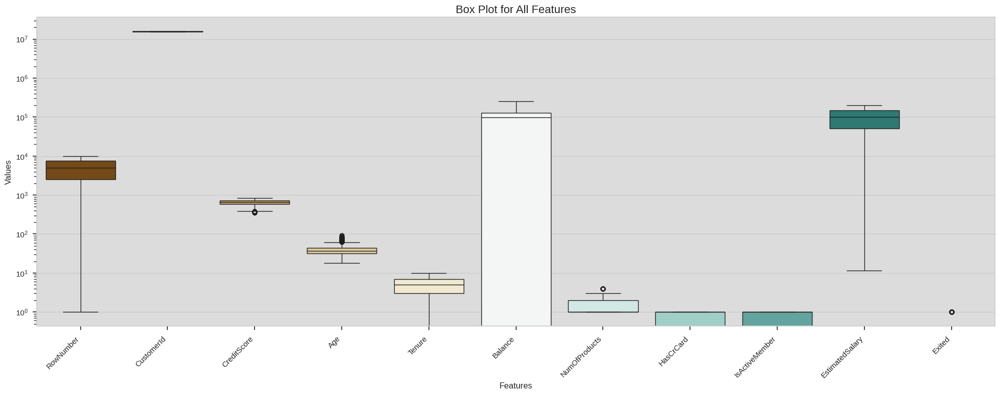

In [128]:
# Creating a boxplot with logarithmic scale for the y-axis
plt.figure(figsize=(20, 8))
ax = sns.boxplot(data=churn_data, palette='BrBG')

# Set plot title and labels
plt.title('Box Plot for All Features', fontsize=16)
plt.xlabel('Features')
plt.ylabel('Values')

# Set y-axis to logarithmic scale
ax.set_yscale('log')

# Improve layout
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save and show plot
plt.show()

#### Key insights from the visual
* it seems like the data doesnot have alot of outliers
* Age and credit score seem to have
* Num products seem to als one


#### EXPLRATORY DATA ANALYSIS

In [129]:
### lets start by building the pandas profiler
## initializing the profile report
from ydata_profiling import ProfileReport
profile_report =  ProfileReport(
    churn_data,
    title="Customized Report",
    minimal=False,
    explorative=True,


)

profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### key observations of the pandas Profiler
* Age has a moderate positive correlation (0.375)
* Number of Products has a notable correlation (0.387)
* There is aPositive correlation between Age and Balance , as the customerss get older , there account balances tend to increase
* Longer Tenure customerss usallly have higher balances

### DATA DISTRIBUTIONS



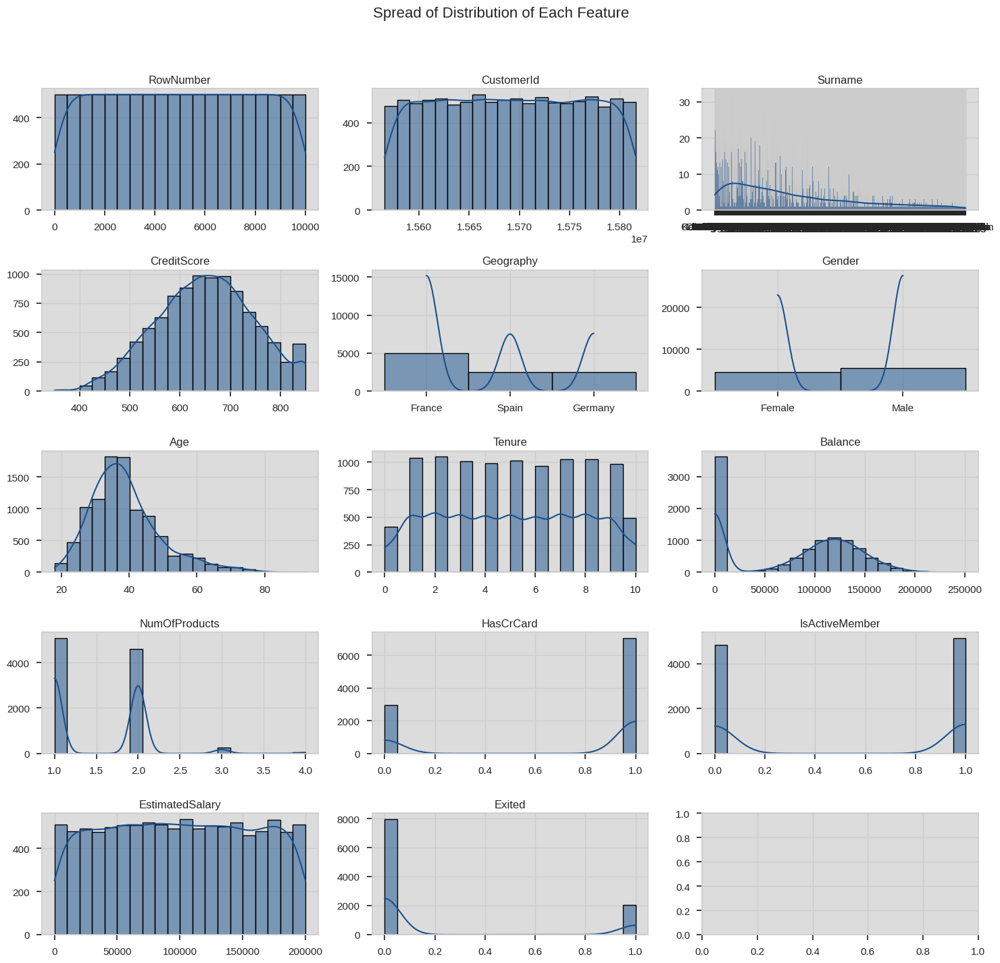

In [130]:
# Generating plots
fig, axes = plt.subplots(5, 3, figsize=(15, 15))  # Adjust number of rows and columns as needed
fig.suptitle('Spread of Distribution of Each Feature', fontsize=16)

# Flatten the axes array for easy iteration
axes = axes.flatten()

for i, column in enumerate(churn_data.columns):
    if i < len(axes):  # Ensure we don't try to plot more columns than we have axes for
        sns.histplot(churn_data[column], bins=20, kde=True, ax=axes[i], color='#195190')
        axes[i].set_title(column)
        axes[i].set_xlabel('')
        axes[i].set_ylabel('')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Save and show plot
plt.show()

### key observations from the Numeric plots
* These features are evenly distributed, indicating that they are unique identifiers and likely irrelevant for predictive modeling or analysis.
* he data is normally distributed with a slight left skew. Most customers have credit scores between 500 and 750, with a few outliers on both ends.
* The majority of customers are from France, followed by Spain and Germany.
* There is a nearly equal distribution between male and female customers
* The distribution is slightly right-skewed, with most customers aged between 25 and 50
* There are fewer older customers (above 60)
* The tenure appears evenly distributed across most levels, but the distribution has slight
* The balance shows a bimodal distribution, with a significant number of customers at zero balance.

### Class Imbalance

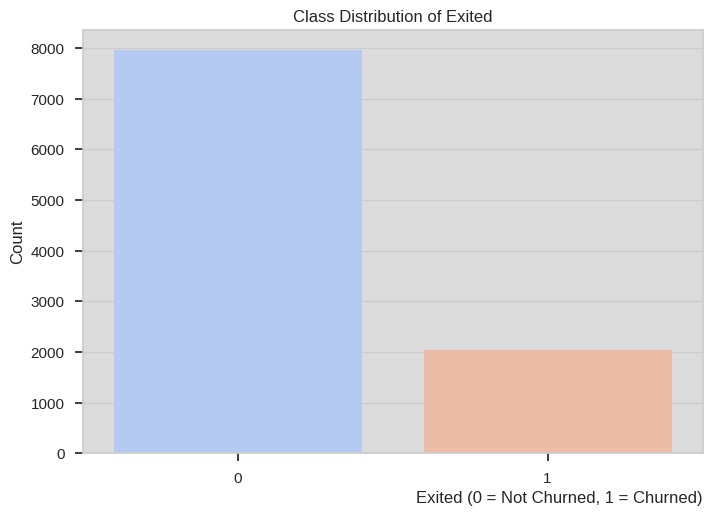

In [131]:

# Bar plot for `Exited` distribution
sns.countplot(data=churn_data, x='Exited', palette='coolwarm')
plt.title('Class Distribution of Exited')
plt.xlabel('Exited (0 = Not Churned, 1 = Churned)',loc='right')
plt.ylabel('Count')
plt.show()

In [132]:
## percentage distribution
# Percentage distribution
churn_data['Exited'].value_counts(normalize=True) * 100


,proportion
Exited,
0,79.63
1,20.37


In [133]:
## diplaying data
churn_data.dtypes

,0
RowNumber,int64
CustomerId,int64
Surname,object
CreditScore,int64
Geography,object
Gender,object
Age,int64
Tenure,int64
Balance,float64
NumOfProducts,int64


In [134]:
####  FEATURE EGINEERING

def create_interaction_features(df):

    # Create a copy of the dataframe
    df_interactions = df.copy()

    # 1. Age-based Interactions
    df_interactions['Age_Balance_Interaction'] = df['Age'] * df['Balance']
    df_interactions['Age_NumProducts_Interaction'] = df['Age'] * df['NumOfProducts']

    # 2. Credit Score Interactions
    df_interactions['CreditScore_Balance_Interaction'] = df['CreditScore'] * df['Balance']
    df_interactions['CreditScore_EstimatedSalary_Interaction'] = df['CreditScore'] * df['EstimatedSalary']

    # 3. Tenure-based Interactions
    df_interactions['Tenure_NumProducts_Interaction'] = df['Tenure'] * df['NumOfProducts']
    df_interactions['Tenure_Balance_Interaction'] = df['Tenure'] * df['Balance']

    # 4. Categorical Interactions
    # One-hot encode categorical variables first
    categorical_features = ['Gender', 'Geography', 'HasCrCard', 'IsActiveMember','NumOfProducts']
    df_encoded = pd.get_dummies(df, columns=categorical_features, prefix='', prefix_sep='')

    # Interaction with Age
    for cat_col in df_encoded.columns:
        if cat_col.startswith(tuple(categorical_features)):
            df_interactions[f'Age_{cat_col}_Interaction'] = df['Age'] * df_encoded[cat_col]

    # 5. Polynomial Features
    df_interactions['Age_Squared'] = df['Age'] ** 2
    df_interactions['Balance_Squared'] = df['Balance'] ** 2
    df_interactions['CreditScore_Squared'] = df['CreditScore'] ** 2

    # 6. Logarithmic Transformations (adding small constant to avoid log(0))
    df_interactions['Log_Balance'] = np.log1p(df['Balance'])
    df_interactions['Log_EstimatedSalary'] = np.log1p(df['EstimatedSalary'])

    # 7. Ratio-based Features
    df_interactions['Balance_to_EstimatedSalary_Ratio'] = df['Balance'] / (df['EstimatedSalary'] + 1)
    df_interactions['NumProducts_to_Tenure_Ratio'] = df['NumOfProducts'] / (df['Tenure'] + 1)

    ## BalanceCategory featur
    df_interactions['BalanceCategory'] = df_interactions['Balance'].apply(lambda x: 'Zero Balance' if x == 0 else 'Non-Zero Balance')

    ## Region churn Rate
    df_interactions['RegionChurnRate'] = df_interactions.groupby('Geography')['Exited'].transform('mean')

    ## Gender churn rate
    df_interactions['RegionChurnRate'] = df_interactions.groupby('Gender')['Exited'].transform('mean')




    return df_interactions


    # Create interaction features
churn_data_egineered = create_interaction_features(churn_data)



In [135]:
## checking the data
churn_data_egineered.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715


In [136]:
## checking for the shape now
churn_data_egineered.shape

(10000, 29)

In [137]:
## dropping features that will not make sense  as they dont meaning for modelling
churn_data_egineered = churn_data_egineered.drop(columns=['RowNumber','CustomerId','Surname'])

In [138]:
## churn_data
churn_data_egineered

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,France,Male,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,Zero Balance,0.164559
9996,516,France,Male,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,Non-Zero Balance,0.164559
9997,709,France,Female,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,Zero Balance,0.250715
9998,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,Non-Zero Balance,0.164559


In [139]:
## checking for info
churn_data_egineered.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 26 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   CreditScore                              10000 non-null  int64  
 1   Geography                                10000 non-null  object 
 2   Gender                                   10000 non-null  object 
 3   Age                                      10000 non-null  int64  
 4   Tenure                                   10000 non-null  int64  
 5   Balance                                  10000 non-null  float64
 6   NumOfProducts                            10000 non-null  int64  
 7   HasCrCard                                10000 non-null  int64  
 8   IsActiveMember                           10000 non-null  int64  
 9   EstimatedSalary                          10000 non-null  float64
 10  Exited                                   10000 

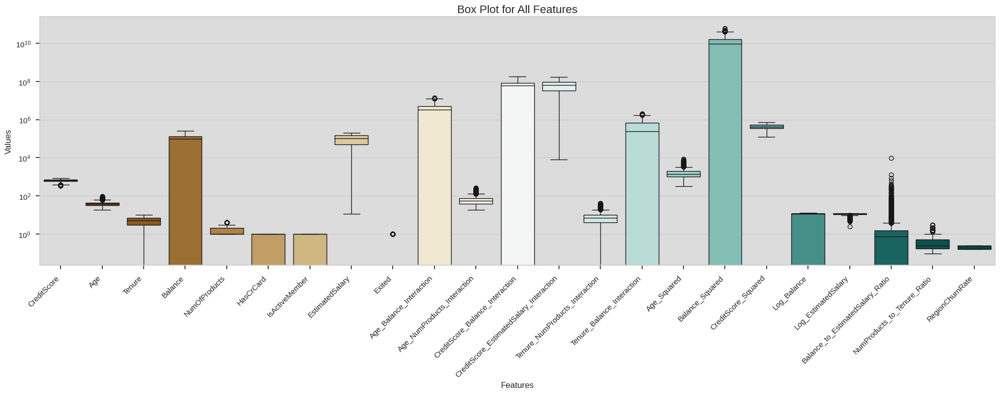

In [140]:
## data distribution
# Creating a boxplot with logarithmic scale for the y-axis
plt.figure(figsize=(20, 8))
ax = sns.boxplot(data=churn_data_egineered, palette='BrBG')

# Set plot title and labels
plt.title('Box Plot for All Features', fontsize=16)
plt.xlabel('Features')
plt.ylabel('Values')

# Set y-axis to logarithmic scale
ax.set_yscale('log')

# Improve layout
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save and show plot
plt.show()

### Key Insights
* Interaction terms like CreditScore_Balance_Interaction, NumProducts_to_Tenure_Ratio exhibit noticeable outliers.
* Interaction terms like Age_Balance_Interaction, CreditScore_EstimatedSalary_Ratio, and squared terms (e.g., Age_Squared, Balance_Squared) appear to extend the feature space by capturing nonlinear or combined effects.


### The Pandas Profiler to explain interactions saving us time


In [141]:
# ### lets start by building the pandas profiler
profile_report =  ProfileReport(
    churn_data_egineered,
    title="Customized Report",
    minimal=False,
    explorative=True,


)

profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [142]:
# churn_data_egineered.to_csv('Churn_data_1.csv', index=False)  # Save to CSV
# churn_data_1 = pd.read_csv(r'D:\python_data_analysis\Analytics\Practice\projects\Churn_data_1.csv')  # Reload the CSV
# profile_report =  ProfileReport(
#     churn_data_1,
#     title="Customized Report",
#     minimal=False,
#     explorative=True,


# )

# profile_report.to_notebook_iframe()

In [143]:
churn_data_egineered

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory,RegionChurnRate
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,Zero Balance,0.250715
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,Non-Zero Balance,0.250715
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,Non-Zero Balance,0.250715
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,Zero Balance,0.250715
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,Non-Zero Balance,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,France,Male,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,Zero Balance,0.164559
9996,516,France,Male,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,Non-Zero Balance,0.164559
9997,709,France,Female,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,Zero Balance,0.250715
9998,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,Non-Zero Balance,0.164559


In [144]:
churn_data_egineered.describe().T

,count,mean,std,min,25%,50%,75%,max
CreditScore,10000.0,6.505288e+02,9.665330e+01,350.000000,5.840000e+02,6.520000e+02,7.180000e+02,8.500000e+02
Age,10000.0,3.892180e+01,1.048781e+01,18.000000,3.200000e+01,3.700000e+01,4.400000e+01,9.200000e+01
Tenure,10000.0,5.012800e+00,2.892174e+00,0.000000,3.000000e+00,5.000000e+00,7.000000e+00,1.000000e+01
Balance,10000.0,7.648589e+04,6.239741e+04,0.000000,0.000000e+00,9.719854e+04,1.276442e+05,2.508981e+05
NumOfProducts,10000.0,1.530200e+00,5.816544e-01,1.000000,1.000000e+00,1.000000e+00,2.000000e+00,4.000000e+00
HasCrCard,10000.0,7.055000e-01,4.558405e-01,0.000000,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
IsActiveMember,10000.0,5.151000e-01,4.997969e-01,0.000000,0.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
EstimatedSalary,10000.0,1.000902e+05,5.751049e+04,11.580000,5.100211e+04,1.001939e+05,1.493882e+05,1.999925e+05
Exited,10000.0,2.037000e-01,4.027686e-01,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
Age_Balance_Interaction,10000.0,2.995492e+06,2.646813e+06,0.000000,0.000000e+00,3.360211e+06,4.911035e+06,1.379695e+07


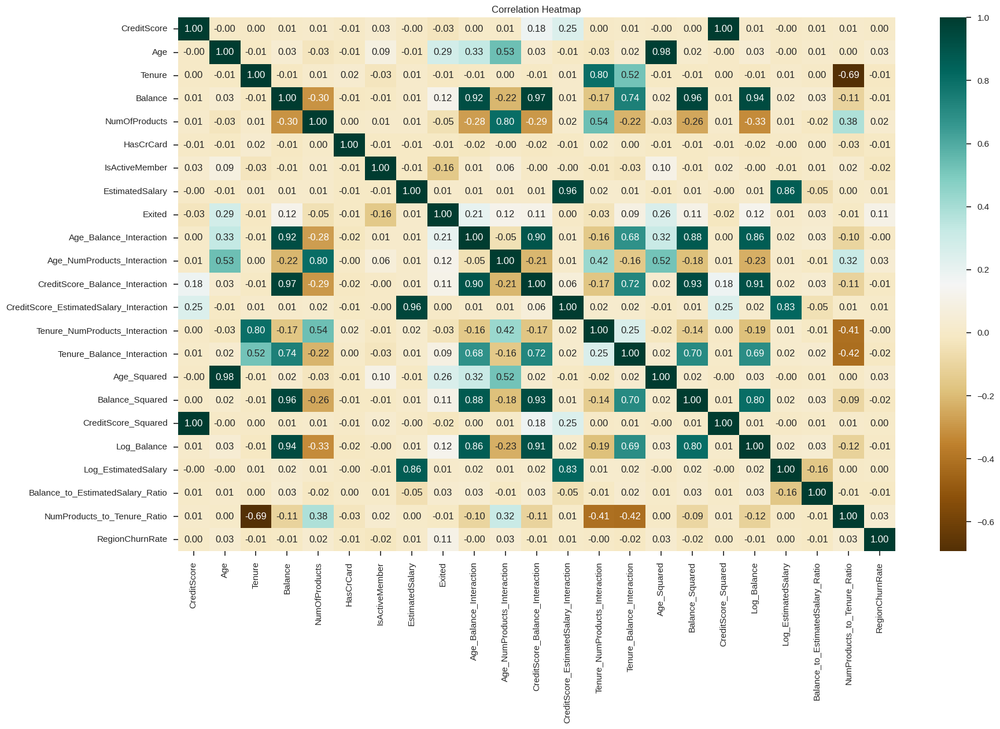

In [145]:
### correlation plot
correlation_matrix = churn_data_egineered.corr(numeric_only=True)
# Create a heatmap
plt.figure(figsize=(20, 12))
sns.heatmap(correlation_matrix, annot=True, cmap="BrBG", fmt=".2f", cbar=True)
plt.title("Correlation Heatmap")
plt.show()

#### Key Insights
* RegionChurnRate shows negligible correlation with other features, suggesting that customer churn may not vary significantly by geographic region.
* Balance also shows a weak negative correlation (-0.17)
* the correlations among most original predictors are near zero. This ensures models won’t suffer heavily from multicollinearity.



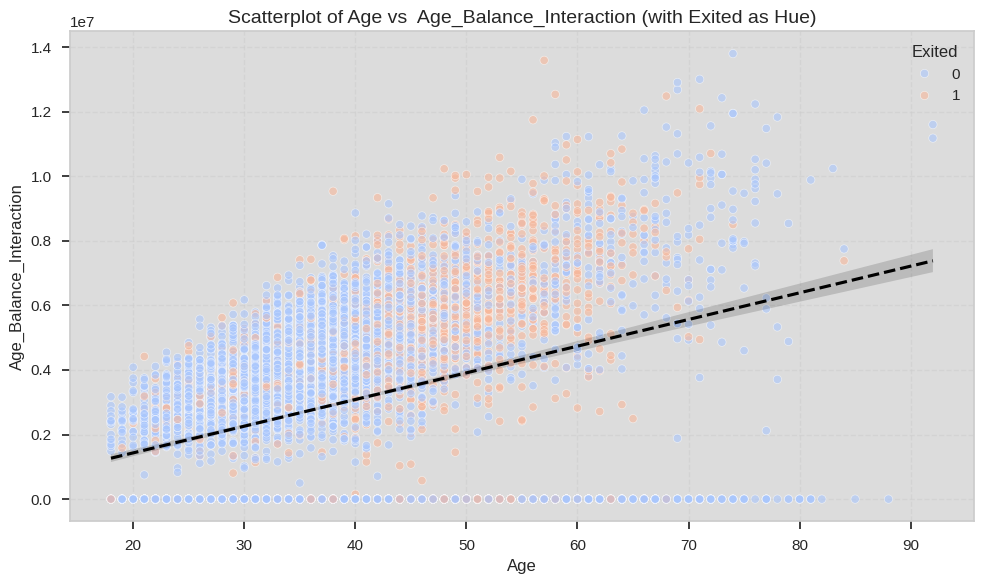

In [146]:
### Note

# Scatterplot for Age vs Balance with a focus on their interaction
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=churn_data_egineered,
    x='Age',
    y='Age_Balance_Interaction',
    hue='Exited',  # Differentiate exited customers
    palette='coolwarm',
    alpha=0.6
)

# Adding a regression line to show trends
sns.regplot(
    data=churn_data_egineered,
    x='Age',
    y='Age_Balance_Interaction',
    scatter=False,
    color='black',
    line_kws={"linestyle": "dashed"}
)

plt.title('Scatterplot of Age vs  Age_Balance_Interaction (with Exited as Hue)', fontsize=14)
plt.xlabel('Age', fontsize=12)
plt.ylabel('Age_Balance_Interaction', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend(title='Exited', loc='upper right')
plt.tight_layout()
plt.show()


In [147]:
### Encoding categorical variables
# Initialize the Binary Encoder
encoder = BinaryEncoder(cols=churn_data_egineered.select_dtypes(include=['object','category']).columns)

# Transform the dataset
binary_encoded_data = encoder.fit_transform(churn_data_egineered)

In [148]:
## checking the binary encoded data
binary_encoded_data

,CreditScore,Geography_0,Geography_1,Gender_0,Gender_1,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory_0,BalanceCategory_1,RegionChurnRate
0,619,0,1,0,1,42,2,0.00,1,1,1,101348.88,1,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,0,1,0.250715
1,608,1,0,0,1,41,1,83807.86,1,0,1,112542.58,0,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,1,0,0.250715
2,502,0,1,0,1,42,8,159660.80,3,1,0,113931.57,1,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,1,0,0.250715
3,699,0,1,0,1,39,1,0.00,2,0,0,93826.63,0,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,0,1,0.250715
4,850,1,0,0,1,43,2,125510.82,1,1,1,79084.10,0,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,1,0,0.250715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,0,1,1,0,39,5,0.00,2,1,0,96270.64,0,0.00,78,0.000000e+00,74224663.44,10,0.00,1521,0.000000e+00,594441,0.000000,11.474929,0.000000,0.333333,0,1,0.164559
9996,516,0,1,1,0,35,10,57369.61,1,1,1,101699.77,0,2007936.35,35,2.960272e+07,52477081.32,10,573696.10,1225,3.291272e+09,266256,10.957287,11.529790,0.564102,0.090909,1,0,0.164559
9997,709,0,1,0,1,36,7,0.00,1,0,1,42085.58,1,0.00,36,0.000000e+00,29838676.22,7,0.00,1296,0.000000e+00,502681,0.000000,10.647484,0.000000,0.125000,0,1,0.250715
9998,772,1,1,1,0,42,3,75075.31,2,1,0,92888.52,1,3153163.02,84,5.795814e+07,71709937.44,6,225225.93,1764,5.636302e+09,595984,11.226260,11.439166,0.808222,0.500000,1,0,0.164559


In [149]:
## asigning the variables
X = binary_encoded_data.drop(columns=['Exited'])
y = binary_encoded_data['Exited']

In [150]:
## print x
X.head()

,CreditScore,Geography_0,Geography_1,Gender_0,Gender_1,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory_0,BalanceCategory_1,RegionChurnRate
0,619,0,1,0,1,42,2,0.00,1,1,1,101348.88,0.00,42,0.000000e+00,62734956.72,2,0.00,1764,0.000000e+00,383161,0.000000,11.526334,0.000000,0.333333,0,1,0.250715
1,608,1,0,0,1,41,1,83807.86,1,0,1,112542.58,3436122.26,41,5.095518e+07,68425888.64,1,83807.86,1681,7.023757e+09,369664,11.336294,11.631096,0.744670,0.500000,1,0,0.250715
2,502,0,1,0,1,42,8,159660.80,3,1,0,113931.57,6705753.60,126,8.014972e+07,57193648.14,24,1277286.40,1764,2.549157e+10,252004,11.980813,11.643362,1.401362,0.333333,1,0,0.250715
3,699,0,1,0,1,39,1,0.00,2,0,0,93826.63,0.00,78,0.000000e+00,65584814.37,2,0.00,1521,0.000000e+00,488601,0.000000,11.449215,0.000000,1.000000,0,1,0.250715
4,850,1,0,0,1,43,2,125510.82,1,1,1,79084.10,5396965.26,43,1.066842e+08,67221485.00,2,251021.64,1849,1.575297e+10,722500,11.740155,11.278280,1.587035,0.333333,1,0,0.250715


In [151]:
## the target variable
y

,Exited
0,1
1,0
2,1
3,0
4,0
...,...
9995,0
9996,0
9997,1
9998,1


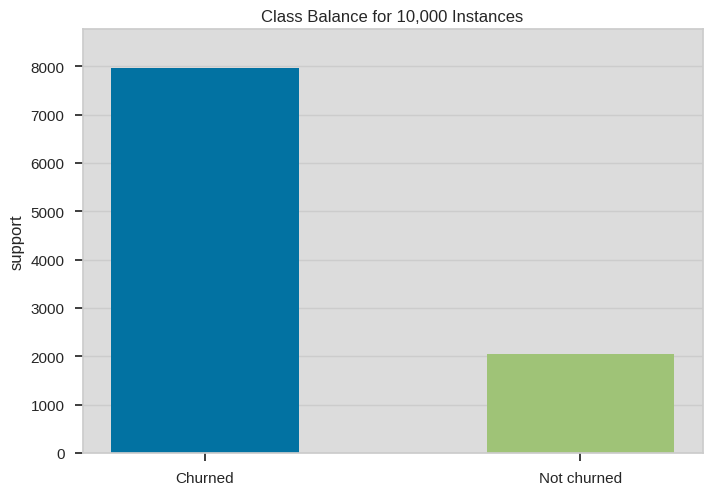

<Axes: title={'center': 'Class Balance for 10,000 Instances'}, ylabel='support'>

In [152]:
## checking the distribution of y
visualizer = class_balance(y ,labels=['Churned','Not churned'])
visualizer.show()


#### Key  Insights
* There is a class imbalance , and we would need to adress that by using SMOTE

In [153]:
## spitting our test int train test split
x_train , x_test , y_train, y_test = train_test_split(X, y , test_size=0.2 , stratify=y,random_state=42)


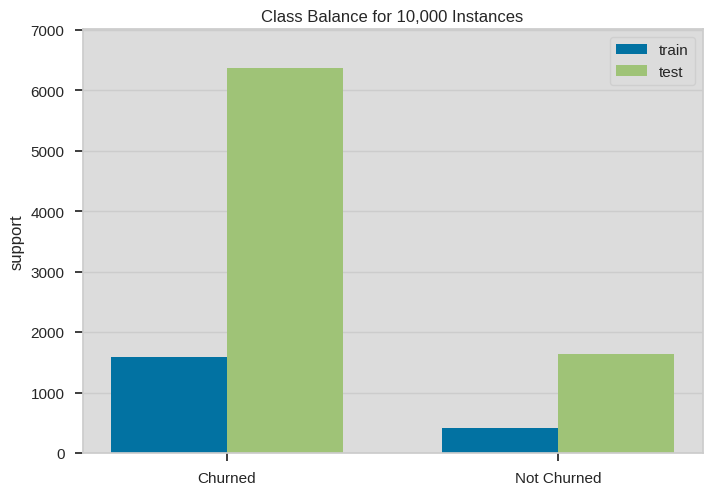

<Axes: title={'center': 'Class Balance for 10,000 Instances'}, ylabel='support'>

In [154]:
## checking the class imabalance after the split
## check the distribution of the target after splitting
visualizer = class_balance(y_test,y_train,labels=['Churned','Not Churned'])
visualizer.show()

In [155]:
### Applying SMOTE
smote = SMOTE(random_state=42)
x_train_resampled, y_train_resampled = smote.fit_resample(x_train, y_train)


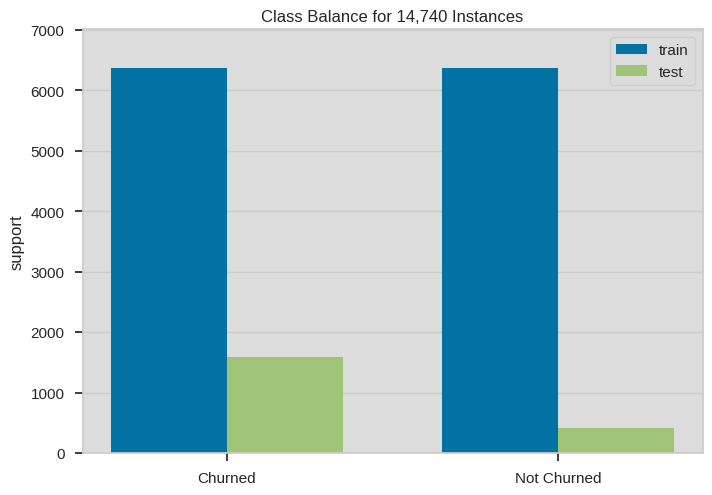

<Axes: title={'center': 'Class Balance for 14,740 Instances'}, ylabel='support'>

In [156]:
## visualizing the target after applying smote
visualizer = class_balance(y_train_resampled,y_test,labels=['Churned','Not Churned'])
visualizer.show()

#### key Insights
* The target variable, train data is now of equal size
* Note , we dont resample the test data coz it may lead to data leakages

In [157]:
## x_train_resampled
x_train_resampled

,CreditScore,Geography_0,Geography_1,Gender_0,Gender_1,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Age_Balance_Interaction,Age_NumProducts_Interaction,CreditScore_Balance_Interaction,CreditScore_EstimatedSalary_Interaction,Tenure_NumProducts_Interaction,Tenure_Balance_Interaction,Age_Squared,Balance_Squared,CreditScore_Squared,Log_Balance,Log_EstimatedSalary,Balance_to_EstimatedSalary_Ratio,NumProducts_to_Tenure_Ratio,BalanceCategory_0,BalanceCategory_1,RegionChurnRate
0,753,0,1,1,0,57,7,0.000000,1,1,0,159475.080000,0.000000e+00,57,0.000000e+00,1.200847e+08,7,0.000000e+00,3249,0.000000e+00,567009,0.000000,11.979649,0.000000,0.125000,0,1,0.164559
1,739,1,1,1,0,32,3,102128.270000,1,1,0,63981.370000,3.268105e+06,32,7.547279e+07,4.728223e+07,3,3.063848e+05,1024,1.043018e+10,546121,11.533995,11.066363,1.596194,0.250000,1,0,0.164559
2,755,1,1,0,1,37,0,113865.230000,2,1,1,117396.250000,4.213014e+06,74,8.596825e+07,8.863417e+07,0,0.000000e+00,1369,1.296529e+10,570025,11.642780,11.673319,0.969914,2.000000,1,0,0.250715
3,561,0,1,1,0,37,5,0.000000,2,1,0,83093.250000,0.000000e+00,74,0.000000e+00,4.661531e+07,10,0.000000e+00,1369,0.000000e+00,314721,0.000000,11.327731,0.000000,0.333333,0,1,0.164559
4,692,1,1,1,0,49,6,110540.430000,2,0,1,107472.990000,5.416481e+06,98,7.649398e+07,7.437131e+07,12,6.632426e+05,2401,1.221919e+10,478864,11.613146,11.585004,1.028532,0.285714,1,0,0.164559
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12735,628,0,1,0,1,39,9,137849.623991,1,1,0,120609.712669,5.409914e+06,39,8.662797e+07,7.561084e+07,9,1.240647e+06,1540,1.900252e+10,395446,11.833926,11.698323,1.147296,0.100000,1,0,0.250715
12736,671,0,0,0,0,54,5,130933.466578,2,1,0,126108.103148,7.139896e+06,109,8.786330e+07,8.439055e+07,10,6.722230e+05,3021,1.714359e+10,451587,11.782452,11.743642,1.040937,0.366491,1,0,0.210570
12737,763,0,0,0,0,38,1,0.000000,2,1,1,82730.355761,0.000000e+00,105,0.000000e+00,6.277439e+07,2,0.000000e+00,1482,0.000000e+00,585374,0.000000,11.320267,0.000000,1.359373,0,1,0.174944
12738,688,1,1,0,1,47,3,103022.557277,1,0,0,139559.197113,4.902806e+06,47,7.093114e+07,9.492189e+07,3,3.275361e+05,2265,1.061365e+10,476801,11.542713,11.833656,0.756588,0.254670,1,0,0.250715


In [158]:
### train the
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import QuantileTransformer,RobustScaler,PolynomialFeatures
import category_encoders as ce
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, r2_score
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Define categorical and numerical columns
# Define categorical and numerical columns
categorical_columns = ['Geography_0','Geography_1','Gender_0','Gender_1','IsActiveMember','HasCrCard','NumOfProducts']
numerical_columns = x_train_resampled.select_dtypes(include=['int64', 'float64']).columns.difference(categorical_columns)

# Numerical pipeline: Impute, transform, scale
numerical_transformers = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='median')),
    ('Robust Scaler',RobustScaler()),
    ('quantile_transform', QuantileTransformer(output_distribution='normal',n_quantiles=1000)),
])

# Categorical pipeline: Impute and binary encode
categorical_transformers = Pipeline(steps=[
    ('impute', SimpleImputer(strategy='most_frequent', fill_value='missing'))

])

# Preprocessor for numerical and categorical merged_data
preprocessor = ColumnTransformer(transformers=[
    ('num', numerical_transformers, numerical_columns),
    ('cat', categorical_transformers, categorical_columns)
], remainder='drop')

# Create the full pipeline
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', LogisticRegression())
])


# Train the model
pipeline.fit(x_train_resampled, y_train_resampled)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('Robust '
                                                                   'Scaler',
                                                                   RobustScaler()),
                                                                  ('quantile_transform',
                                                                   QuantileTransformer(output_distribution='normal'))]),
                                                  Index(['Age', 'Age_Balance_Interaction', 'Age_NumProducts_Interaction',
       'Age_Squared', 'Balance', 'BalanceCategory_...
       'NumProducts_to_Tenure_Ratio', 'RegionChurnRate', 'Tenure',
       'Tenure_Balance_Interaction', 'Tenure_NumProducts_Interaction'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='most_frequent'))]),
                                                  ['Geography_0', 'Geography_1',
                                                   'Gender_0', 'Gender_1',
                                                   'IsActiveMember',
                                                   'HasCrCard',
                                                   'NumOfProducts'])])),
                ('model', LogisticRegression())])

In [159]:
## making predictions
from sklearn.metrics import accuracy_score
y_pred = pipeline.predict(x_train_resampled)
## evaluate the model
print(f'The acuraccy score is {accuracy_score(y_train_resampled, y_pred)}')

The acuraccy score is 0.839403453689168


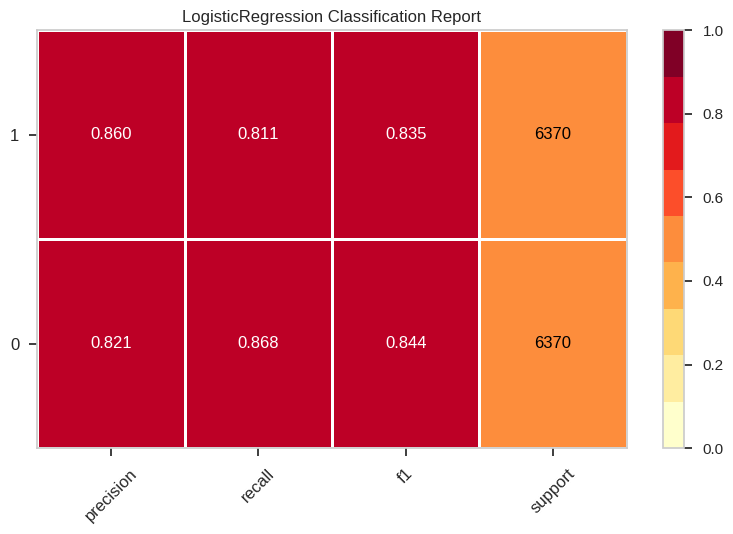

In [160]:
from yellowbrick.classifier import classification_report
visualizer = classification_report(pipeline,x_train_resampled , y_train_resampled,classe=['Churned','Not churned'],support=True)

In [161]:
## Evaluation of logistic Regression on thee Unseen data
from sklearn.metrics import accuracy_score
y_pred = pipeline.predict(x_test)
## evaluate the model
print(f'The acuraccy score is {accuracy_score(y_test, y_pred)}')

The acuraccy score is 0.7805


In [165]:
from sklearn.metrics import classification_report

report = classification_report(y_test, y_pred, target_names=['Not churned', 'Churned'], output_dict=False)



In [166]:
print(report)

              precision    recall  f1-score   support

 Not churned       0.86      0.87      0.86      1593
     Churned       0.46      0.42      0.44       407

    accuracy                           0.78      2000
   macro avg       0.66      0.65      0.65      2000
weighted avg       0.77      0.78      0.78      2000



In [168]:
## Random forest classifier
# Define the Linear Regression model
XGB_classifier = XGBClassifier()

# Replace the model in the existing pipeline
pipeline.set_params(model=XGB_classifier)

# Fit the pipeline with training data
pipeline.fit(x_train_resampled, y_train_resampled)



Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('Robust '
                                                                   'Scaler',
                                                                   RobustScaler()),
                                                                  ('quantile_transform',
                                                                   QuantileTransformer(output_distribution='normal'))]),
                                                  Index(['Age', 'Age_Balance_Interaction', 'Age_NumProducts_Interaction',
       'Age_Squared', 'Balance', 'BalanceCategory_...
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=None, n_jobs=None,
                               num_parallel_tree=None, random_state=None, ...))])

In [169]:
## Evaluate on the test data
y_pred = pipeline.predict(x_test)
## evaluate the model
print(f'The acuraccy score is {accuracy_score(y_test, y_pred)}')

The acuraccy score is 0.8505


In [173]:
## confusion matric
from sklearn.metrics import confusion_matrix
confusion_mat = confusion_matrix(y_test, y_pred)

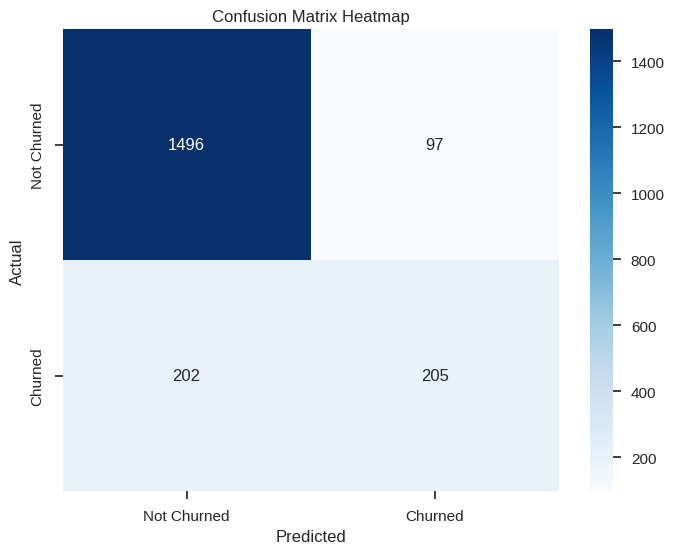

In [174]:
# Correcting the heatmap plotting code
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_mat, annot=True, fmt='d', cmap='Blues', cbar=True, xticklabels=['Churned', 'Not Churned'],
            yticklabels=['Not Churned', 'Churned'])
plt.title('Confusion Matrix Heatmap')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


In [181]:
## the cat boost Regressor
# Define the Lineear Regression
catboost_classifier = CatBoostClassifier(         # Number of boosting rounds; reduce to 500 if training is too slow.
         # Balanced learning rate for gradual convergence       # Ensures reproducibility.
    silent=True   )

# Replace the model in the existing pipeline
pipeline.set_params(model= catboost_classifier)

# Fit the pipeline with training data
pipeline.fit(x_train_resampled, y_train_resampled)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('Robust '
                                                                   'Scaler',
                                                                   RobustScaler()),
                                                                  ('quantile_transform',
                                                                   QuantileTransformer(output_distribution='normal'))]),
                                                  Index(['Age', 'Age_Balance_Interaction', 'Age_NumProducts_Interaction',
       'Age_Squared', 'Balance', 'BalanceCategory_...
       'NumProducts_to_Tenure_Ratio', 'RegionChurnRate', 'Tenure',
       'Tenure_Balance_Interaction', 'Tenure_NumProducts_Interaction'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='most_frequent'))]),
                                                  ['Geography_0', 'Geography_1',
                                                   'Gender_0', 'Gender_1',
                                                   'IsActiveMember',
                                                   'HasCrCard',
                                                   'NumOfProducts'])])),
                ('model',
                 <catboost.core.CatBoostClassifier object at 0x7f8f1510c790>)])

In [176]:
## Evaluate on the test data
y_pred = pipeline.predict(x_test)
## evaluate the model
print(f'The acuraccy score is {accuracy_score(y_test, y_pred)}')

The acuraccy score is 0.858


In [177]:
## the cat boost clasification report
from sklearn.metrics import classification_report

report = classification_report(y_test, y_pred, target_names=['Not churned', 'Churned'], output_dict=False)
print(report)

              precision    recall  f1-score   support

 Not churned       0.89      0.94      0.91      1593
     Churned       0.70      0.53      0.60       407

    accuracy                           0.86      2000
   macro avg       0.79      0.74      0.76      2000
weighted avg       0.85      0.86      0.85      2000



In [178]:
##  confusion matrix for the catboost
from sklearn.metrics import confusion_matrix
confusion_mat = confusion_matrix(y_test, y_pred)


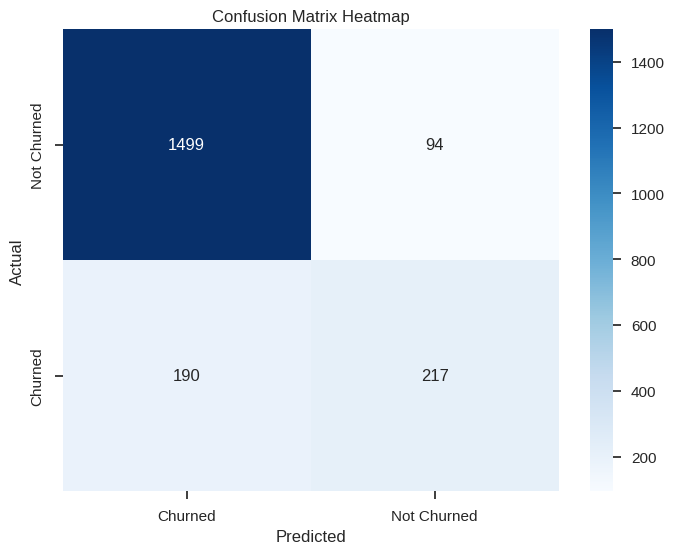

In [179]:
## heat map showing the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_mat, annot=True, fmt='d', cmap='Blues', cbar=True, xticklabels=['Churned', 'Not Churned'],
            yticklabels=['Not Churned', 'Churned'])
## display
plt.title('Confusion Matrix Heatmap')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [184]:
# Predict probabilities for the positive class
y_pred_proba = pipeline.predict_proba(x_test)[:, 1]

In [185]:
# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f"ROC AUC Score: {roc_auc:.2f}")


ROC AUC Score: 0.86


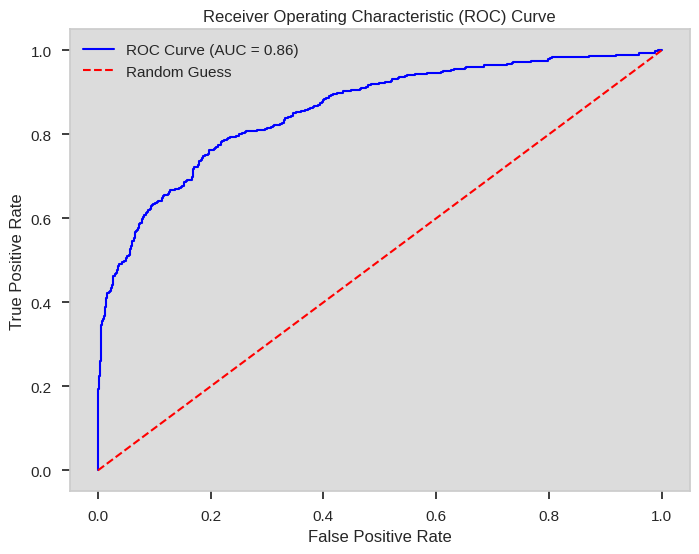

In [186]:
# Compute the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], color='red', linestyle='--', label="Random Guess")
plt.title("Receiver Operating Characteristic (ROC) Curve")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid()
plt.show()



**Random Forest Classifier**

In [187]:
## Random forest classifier
Random_Forest_classifier = RandomForestClassifier(random_state=42)

# Replace the model in the existing pipeline
pipeline.set_params(model=Random_Forest_classifier)

# Fit the pipeline with training data
pipeline.fit(x_train_resampled, y_train_resampled)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('Robust '
                                                                   'Scaler',
                                                                   RobustScaler()),
                                                                  ('quantile_transform',
                                                                   QuantileTransformer(output_distribution='normal'))]),
                                                  Index(['Age', 'Age_Balance_Interaction', 'Age_NumProducts_Interaction',
       'Age_Squared', 'Balance', 'BalanceCategory_...
       'NumProducts_to_Tenure_Ratio', 'RegionChurnRate', 'Tenure',
       'Tenure_Balance_Interaction', 'Tenure_NumProducts_Interaction'],
      dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('impute',
                                                                   SimpleImputer(fill_value='missing',
                                                                                 strategy='most_frequent'))]),
                                                  ['Geography_0', 'Geography_1',
                                                   'Gender_0', 'Gender_1',
                                                   'IsActiveMember',
                                                   'HasCrCard',
                                                   'NumOfProducts'])])),
                ('model', RandomForestClassifier(random_state=42))])

**Evaluation Metrics**

In [188]:
## accuracy
y_pred = pipeline.predict(x_test)
## evaluate the model
print(f'The acuraccy score is {accuracy_score(y_test, y_pred)}')


The acuraccy score is 0.842


In [189]:
## Presion
from sklearn.metrics import precision_score
precision = precision_score(y_test, y_pred)
print(f"Precision: {precision:.2f}")

Precision: 0.63


In [190]:
## F1 score
from sklearn.metrics import f1_score
f1 = f1_score(y_test, y_pred)
print(f"F1 Score: {f1:.2f}")

F1 Score: 0.58


In [192]:
## recall
from sklearn.metrics import recall_score
recall = recall_score(y_test, y_pred)
print(f"Recall: {recall:.2f}")




Recall: 0.54


In [193]:
### confusion matrix znd heatmap
from sklearn.metrics import confusion_matrix
confusion_mat = confusion_matrix(y_test, y_pred)

Text(62.388888888888886, 0.5, 'Actual')

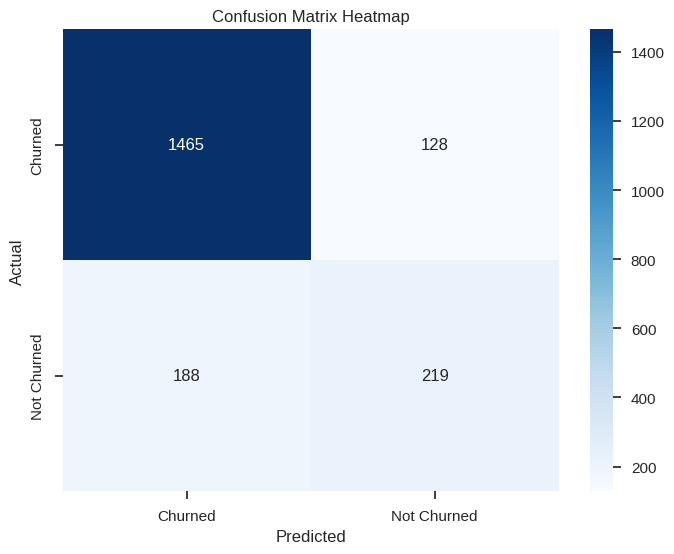

In [195]:
## heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_mat, annot=True, fmt='d', cmap='Blues', cbar=True, xticklabels=['Churned', 'Not Churned'],
            yticklabels=['Churned', 'Not Churned'])
plt.title('Confusion Matrix Heatmap')
plt.xlabel('Predicted')
plt.ylabel('Actual')

In [200]:
## The reciever operating chararistics
from sklearn.metrics import roc_curve, roc_auc_score
# Predict probabilities for the positive class
y_pred_proba = pipeline.predict_proba(x_test)[:, 1]


In [201]:
# Calculate ROC AUC score
roc_auc = roc_auc_score(y_test, y_pred_proba)
print(f"ROC AUC Score: {roc_auc:.2f}")


ROC AUC Score: 0.84


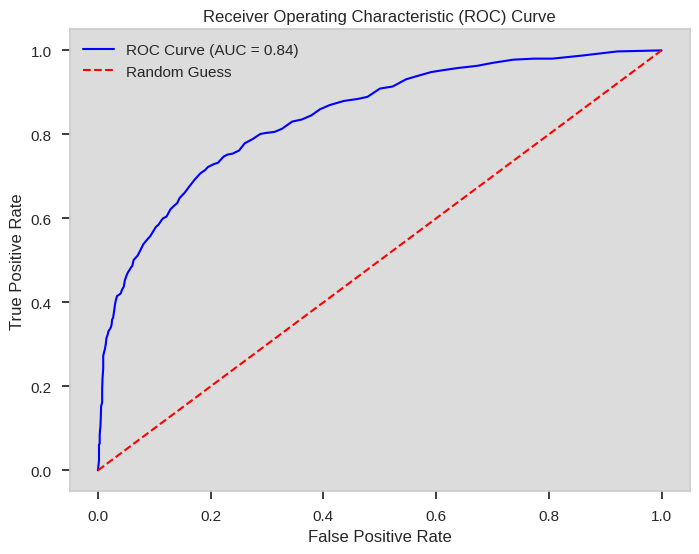

In [202]:
# Compute the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], color='red', linestyle='--', label="Random Guess")
plt.title("Receiver Operating Characteristic (ROC) Curve")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid()
plt.show()

